# **Generative Adversarial Network (GAN) for Cat Face Generation**

In this notebook, we implement and train a Deep Convolutional GAN (DCGAN) to generate 64×64 RGB cat faces.

## **Goals of this notebook**

- Load and preprocess the dataset  
- Build a DCGAN from scratch:
  - A generator that maps random noise to images  
  - A discriminator that distinguishes real images from generated ones  
- Train both networks in an adversarial setup  
- Monitor training dynamics through loss curves  
- Visualize generated samples at different stages of training  
- Save the trained model for later comparison with the VAE and the diffusion model

## **Why use a GAN?**

GANs can generate sharp and detailed images, often outperforming VAEs in visual quality.  
They introduce an adversarial objective where the generator improves by trying to fool the discriminator—leading to more realistic samples.

This notebook serves as the second step in comparing different generative approaches.

In [1]:
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import zipfile
from pathlib import Path

import torch
import torch.nn as nn
from torch.utils.data import DataLoader, TensorDataset
import torch.optim as optim
import torch.nn.functional as F

In [2]:
# Check CUDA availability
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f"Using device: {device}")

Using device: cpu


## **Data Collection and Loading**

We load the 64×64 RGB cat face images from disk, resize them if needed, and store them in a NumPy array.  
Basic info (count, shape, value range) is displayed to confirm that the dataset is properly loaded.

In [3]:
# Dataset URL from Kaggle (direct download)
# Note: You may need to download manually from:
# https://www.kaggle.com/datasets/spandan2/cats-faces-64x64-for-generative-models

# For this exercise, we'll assume you have downloaded and extracted the dataset
data_dir = '../data/cats_dataset'  # Update this path to your dataset location


# If you have the dataset as a zip file, uncomment to extract:
with zipfile.ZipFile('../data/archive.zip', 'r') as zip_ref:
    zip_ref.extractall("../data")

print(f"Dataset directory: {data_dir}")

Dataset directory: ../data/cats_dataset


In [4]:
def load_cat_images(data_dir, max_images=None):
    """
    Load cat face images from directory
    Returns: numpy array of shape (n_samples, 64, 64, 3)
    """
    image_files = list(Path(data_dir).glob('*.jpg')) + list(Path(data_dir).glob('*.png'))
    
    if max_images:
        image_files = image_files[:max_images]
    
    images = []
    for img_path in image_files:
        img = Image.open(img_path).convert('RGB')
        img = img.resize((64, 64))  # Ensure 64x64
        images.append(np.array(img))
    
    return np.array(images)


In [5]:
data_dir="../data/cats"
# Load images
images = load_cat_images(data_dir)
print(f"Loaded {len(images)} images")
print(f"Image shape: {images[1].shape}")
print(f"Data type: {images.dtype}")
print(f"Value range: [{images.min()}, {images.max()}]")

Loaded 15747 images
Image shape: (64, 64, 3)
Data type: uint8
Value range: [0, 255]


## **Data Visualization**

Below we display a few sample images from the dataset to verify that the data has been loaded correctly and to get a quick sense of the visual content we will train the model on.


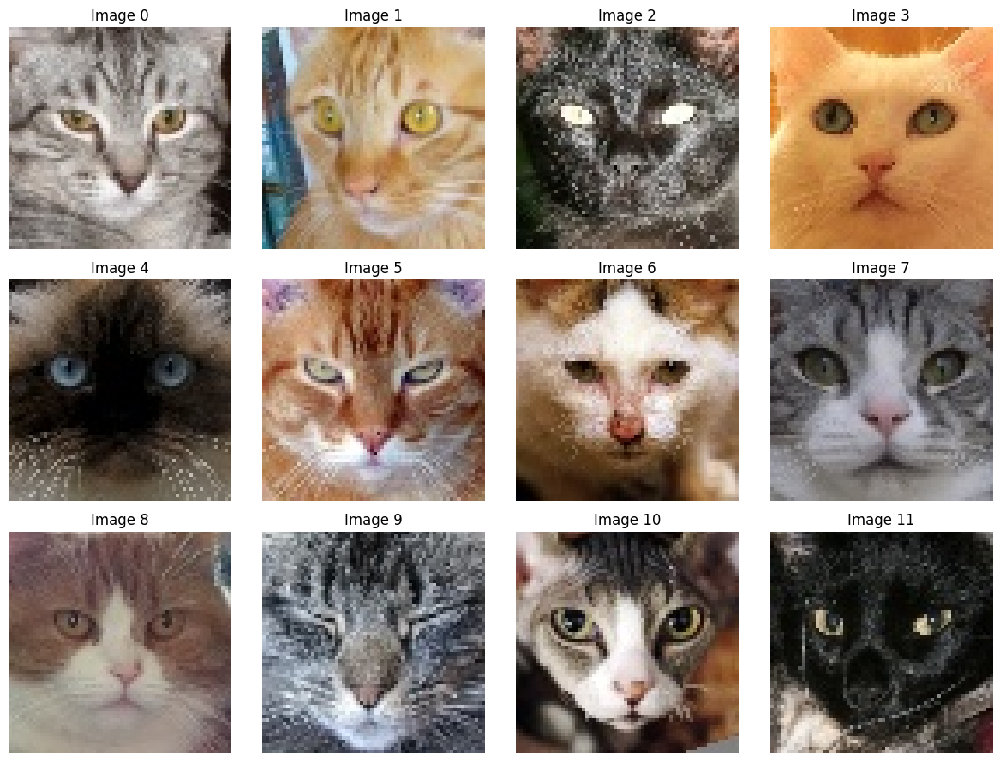

In [6]:
fig, axes = plt.subplots(3, 4, figsize=(12, 9))
axes = axes.flatten()

for i in range(12):
    axes[i].imshow(images[i])
    axes[i].axis('off')
    axes[i].set_title(f'Image {i}')

plt.tight_layout()
plt.show()

## **Data Preparation**

Before training the GAN, we prepare the dataset of cat faces using three simple steps:

1. **Normalize pixel values to [-1, 1]**  
   GAN generators typically use a `tanh` activation, which outputs values in the range `[-1, 1]`.  
   We therefore scale the original `[0, 255]` RGB values accordingly.

2. **Reorder image dimensions for PyTorch**  
   PyTorch expects images in the format **(channels, height, width)**.  
   We transpose the loaded images from `(H, W, C)` to `(C, H, W)`.

3. **Split into training and validation sets**  
   We use 90% of the images for training and keep 10% for validation.  
   This allows us to monitor training stability and detect potential mode collapse.

The resulting tensors are wrapped in PyTorch `Dataset` and `DataLoader` objects, which will feed mini-batches to the GAN during training.

In [7]:
#Preprocessing pour Gan model
images_normalized = (images.astype('float32') - 127.5) / 127.5

images_normalized = images_normalized.transpose(0,3,1,2)
print(f"Normalized shape: {images_normalized.shape}")
print(f"Normalized range: [{images_normalized.min():.3f}, {images_normalized.max():.3f}]")

# Split into train/validation sets
split_idx = int(0.9 * len(images_normalized))
train_images = images_normalized[:split_idx]
val_images = images_normalized[split_idx:]

print(f"\nTraining samples: {len(train_images)}")
print(f"Validation samples: {len(val_images)}")


train_images_tensor=torch.tensor(train_images).to(torch.float32)
val_images_tensor=torch.tensor(val_images).to(torch.float32)

train_dataset=TensorDataset(train_images_tensor)
val_dataset=TensorDataset(val_images_tensor)

batch_size=64

train_loader=DataLoader(train_dataset,batch_size=batch_size,shuffle=True)
val_loader=DataLoader(val_dataset, batch_size=batch_size,shuffle=True)

Normalized shape: (15747, 3, 64, 64)
Normalized range: [-1.000, 1.000]

Training samples: 14172
Validation samples: 1575


# **DCGAN Architecture Overview**

In this section, we implement a **Deep Convolutional Generative Adversarial Network (DCGAN)** to generate 64×64 RGB images of cat faces.  
The model follows the classical DCGAN architecture introduced by Radford et al. (2015), using transposed convolutions in the generator and strided convolutions in the discriminator.

---

## **1. Generator**

The **Generator (G)** transforms a random latent vector \( z \in \mathbb{R}^{\text{latent\_dim}} \) into a 64×64 RGB image.  
It starts from a spatial resolution of **1×1** and progressively upsamples the feature maps to **64×64** using a sequence of `ConvTranspose2d` layers.

**Main characteristics:**

- Input latent vector reshaped to `(B, latent_dim, 1, 1)`
- Spatial upsampling: 1×1 → 4×4 → 8×8 → 16×16 → 32×32 → 64×64
- `BatchNorm2d` after each convolution (except the output layer)
- `ReLU` activations
- Final `Tanh()` to output pixels in **[-1, 1]**

This architecture encourages stable gradients and learned spatial structure.

---

## **2. Discriminator**

The **Discriminator (D)** takes an image (real or generated) and predicts whether it is authentic.  
It acts as a binary classifier composed of strided `Conv2d` layers that gradually reduce spatial resolution.

**Main characteristics:**

- Input: `(B, 3, 64, 64)`
- Downsampling through stacked convolutions: 64×64 → 32×32 → 16×16 → 8×8 → 4×4 → 1×1
- `LeakyReLU(0.2)` activations
- `BatchNorm2d` on all layers except the first
- Final `Sigmoid()` producing a probability in **[0, 1]**

The discriminator provides the adversarial signal that forces the generator to improve.

---

## **3. Adversarial Training Objective**

The generator and discriminator engage in a min–max adversarial game:

- **D** learns to classify real images as *real* and generated images as *fake*.
- **G** learns to fool D into classifying generated images as *real*.

We use:

- **Binary Cross-Entropy loss (BCE)**  
- **Adam optimizers** with DCGAN-friendly parameters (`betas ≈ (0.5, 0.999)` or close variants)
- **Label smoothing** and **instance noise** to stabilize training

---

## **4. Expected Behavior**

- After a few epochs, generated samples should exhibit recognizable shapes and color structure.
- With sustained training (20–50+ epochs), G should produce realistic 64×64 cat faces.
- The losses of G and D generally oscillate but remain bounded and balanced.

In [8]:
class Generator(nn.Module):
    def __init__(self, latent_dim=100):
        super().__init__()
        self.latent_dim = latent_dim

        self.net = nn.Sequential(
            # input: (B, latent_dim, 1, 1)
            nn.ConvTranspose2d(latent_dim, 512, 4, 1, 0),   # -> (B, 512, 4, 4)
            nn.BatchNorm2d(512),
            nn.ReLU(True),

            nn.ConvTranspose2d(512, 256, 4, 2, 1),          # -> (B, 256, 8, 8)
            nn.BatchNorm2d(256),
            nn.ReLU(True),

            nn.ConvTranspose2d(256, 128, 4, 2, 1),          # -> (B, 128, 16, 16)
            nn.BatchNorm2d(128),
            nn.ReLU(True),

            nn.ConvTranspose2d(128, 64, 4, 2, 1),           # -> (B, 64, 32, 32)
            nn.BatchNorm2d(64),
            nn.ReLU(True),

            nn.ConvTranspose2d(64, 3, 4, 2, 1),             # -> (B, 3, 64, 64)
            nn.Tanh()
        )

    def forward(self, z):
        # z: (B, latent_dim)
        z = z.view(z.size(0), self.latent_dim, 1, 1)
        x = self.net(z)
        return x

class Discriminator(nn.Module):
    def __init__(self):
        super().__init__()
        self.net = nn.Sequential(
            # input: (B, 3, 64, 64)
            nn.Conv2d(3, 64, 4, 2, 1),      # -> (B, 64, 32, 32)
            nn.LeakyReLU(0.2, inplace=True),

            nn.Conv2d(64, 128, 4, 2, 1),    # -> (B, 128, 16, 16)
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2, inplace=True),

            nn.Conv2d(128, 256, 4, 2, 1),   # -> (B, 256, 8, 8)
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2, inplace=True),

            nn.Conv2d(256, 512, 4, 2, 1),   # -> (B, 512, 4, 4)
            nn.BatchNorm2d(512),
            nn.LeakyReLU(0.2, inplace=True),

            nn.Conv2d(512, 1, 4, 1, 0),     # -> (B, 1, 1, 1)
            nn.Sigmoid()
        )

    def forward(self, x):
        out = self.net(x)
        return out.view(-1, 1)   # (B, 1)

In [9]:
latent_dim = 100
G = Generator(latent_dim).to(device)
D = Discriminator().to(device)

z = torch.randn(16, latent_dim).to(device)
fake = G(z)
print("fake:", fake.shape)   # attendu: torch.Size([16, 3, 64, 64])

out = D(fake)
print("D(fake):", out.shape) # attendu: torch.Size([16, 1])

fake: torch.Size([16, 3, 64, 64])
D(fake): torch.Size([16, 1])


fake: torch.Size([16, 3, 64, 64])
D(fake): torch.Size([16, 1])
Epoch [1/100]  D_loss: 0.7034  G_loss: 1.3716
Epoch [2/100]  D_loss: 1.1205  G_loss: 2.8948
Epoch [3/100]  D_loss: 1.2286  G_loss: 2.0532
Epoch [4/100]  D_loss: 1.3991  G_loss: 0.7541
Epoch [5/100]  D_loss: 1.1920  G_loss: 1.8739


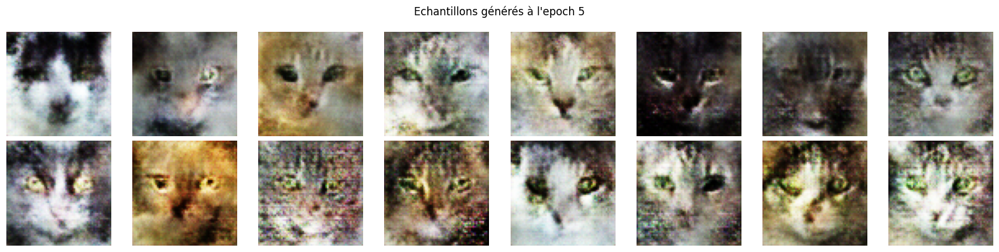

Epoch [6/100]  D_loss: 1.1192  G_loss: 0.7779
Epoch [7/100]  D_loss: 1.0875  G_loss: 0.7500
Epoch [8/100]  D_loss: 0.9333  G_loss: 1.7792
Epoch [9/100]  D_loss: 0.9653  G_loss: 0.8771
Epoch [10/100]  D_loss: 1.2180  G_loss: 2.4850


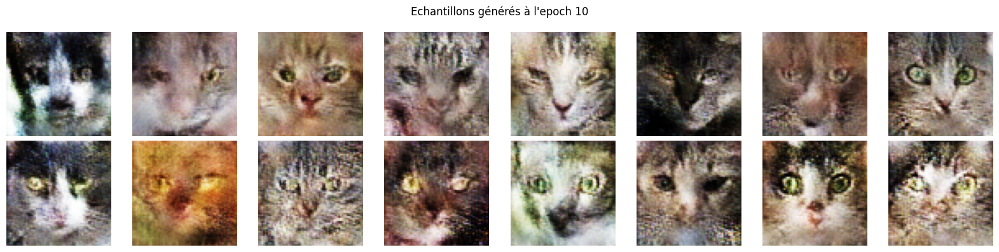

Epoch [11/100]  D_loss: 0.8203  G_loss: 0.8051
Epoch [12/100]  D_loss: 0.8533  G_loss: 0.9310
Epoch [13/100]  D_loss: 1.3221  G_loss: 0.3636
Epoch [14/100]  D_loss: 1.1755  G_loss: 0.4811
Epoch [15/100]  D_loss: 0.9692  G_loss: 2.5456


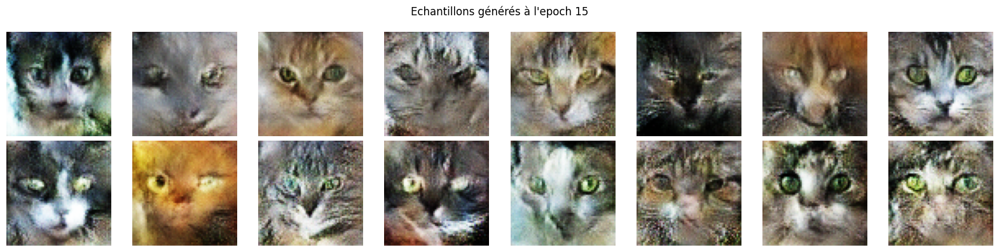

Epoch [16/100]  D_loss: 0.7931  G_loss: 0.7423
Epoch [17/100]  D_loss: 0.6624  G_loss: 0.6574
Epoch [18/100]  D_loss: 0.7867  G_loss: 1.0785
Epoch [19/100]  D_loss: 1.5903  G_loss: 0.7538
Epoch [20/100]  D_loss: 0.9153  G_loss: 0.4254


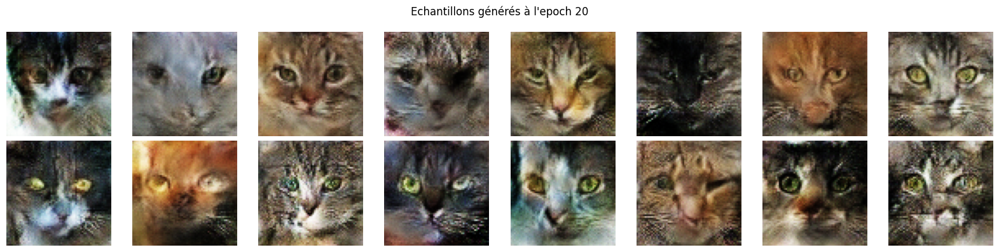

Epoch [21/100]  D_loss: 0.6418  G_loss: 0.4283
Epoch [22/100]  D_loss: 0.6283  G_loss: 0.4715
Epoch [23/100]  D_loss: 0.4336  G_loss: 1.2013
Epoch [24/100]  D_loss: 0.5428  G_loss: 0.4775
Epoch [25/100]  D_loss: 0.6759  G_loss: 0.5187


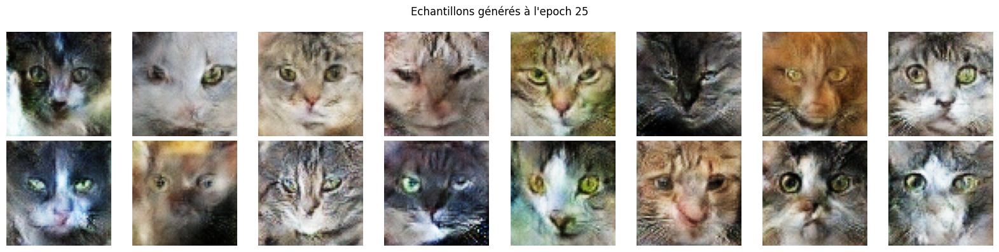

Epoch [26/100]  D_loss: 0.5670  G_loss: 0.3530
Epoch [27/100]  D_loss: 0.4421  G_loss: 0.6878
Epoch [28/100]  D_loss: 0.6188  G_loss: 1.3536
Epoch [29/100]  D_loss: 0.7635  G_loss: 0.3889
Epoch [30/100]  D_loss: 0.4555  G_loss: 0.8411


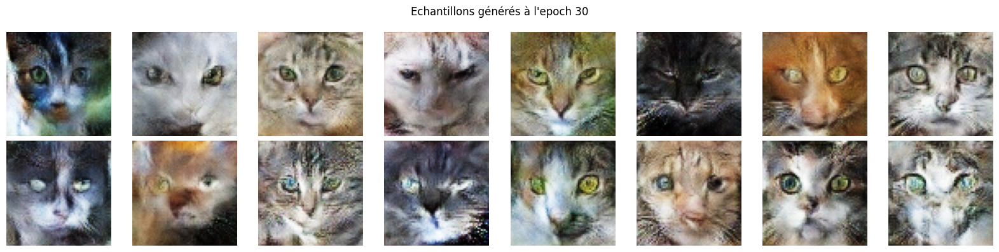

Epoch [31/100]  D_loss: 0.4839  G_loss: 0.8143
Epoch [32/100]  D_loss: 0.5672  G_loss: 0.7394
Epoch [33/100]  D_loss: 0.4986  G_loss: 0.8582
Epoch [34/100]  D_loss: 0.4547  G_loss: 0.6187
Epoch [35/100]  D_loss: 0.4918  G_loss: 0.6322


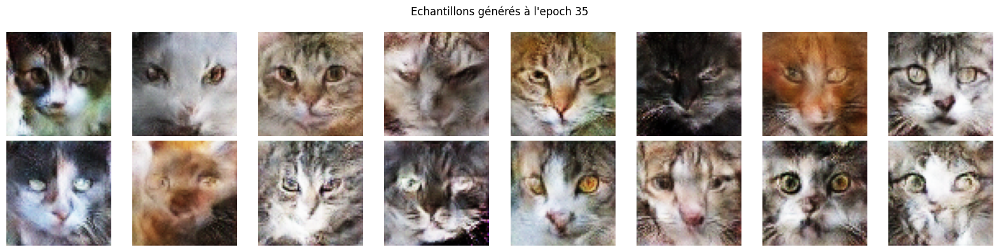

Epoch [36/100]  D_loss: 0.6197  G_loss: 0.7248
Epoch [37/100]  D_loss: 0.4168  G_loss: 0.6922
Epoch [38/100]  D_loss: 0.5551  G_loss: 0.4520
Epoch [39/100]  D_loss: 0.4436  G_loss: 0.3943
Epoch [40/100]  D_loss: 0.4623  G_loss: 1.0731


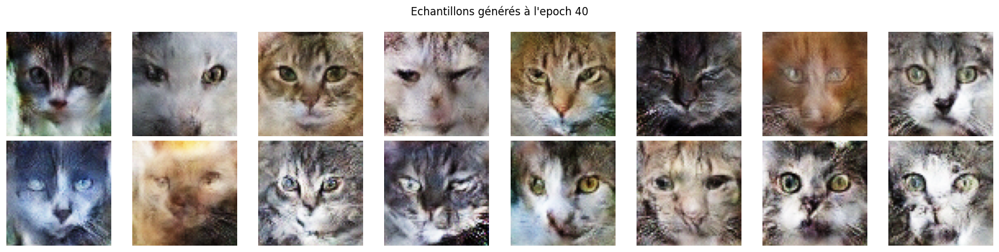

Epoch [41/100]  D_loss: 0.4077  G_loss: 1.5590
Epoch [42/100]  D_loss: 0.6140  G_loss: 2.4814
Epoch [43/100]  D_loss: 2.6907  G_loss: 7.2838
Epoch [44/100]  D_loss: 0.4452  G_loss: 0.8341
Epoch [45/100]  D_loss: 0.6715  G_loss: 1.6100


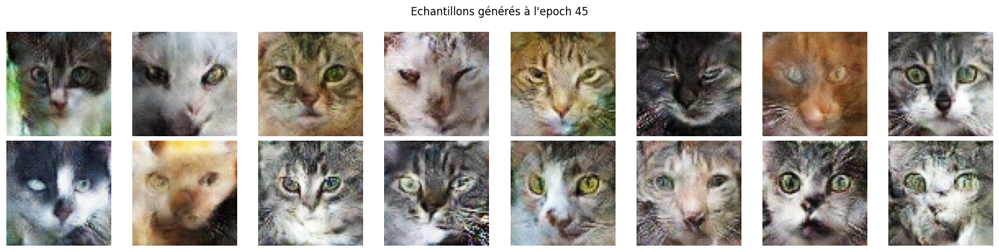

Epoch [46/100]  D_loss: 0.4464  G_loss: 0.5850
Epoch [47/100]  D_loss: 0.5493  G_loss: 0.6359
Epoch [48/100]  D_loss: 0.4754  G_loss: 1.1254
Epoch [49/100]  D_loss: 0.4613  G_loss: 1.3875
Epoch [50/100]  D_loss: 0.3742  G_loss: 0.8961


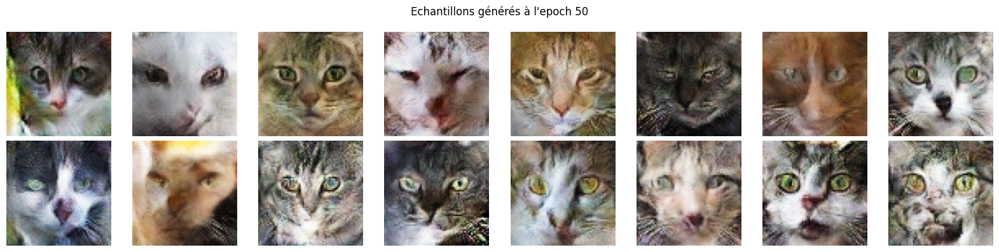

Epoch [51/100]  D_loss: 0.5124  G_loss: 1.7461
Epoch [52/100]  D_loss: 0.4395  G_loss: 0.4972
Epoch [53/100]  D_loss: 0.4592  G_loss: 0.6113
Epoch [54/100]  D_loss: 0.4446  G_loss: 0.4891
Epoch [55/100]  D_loss: 0.4691  G_loss: 0.5451


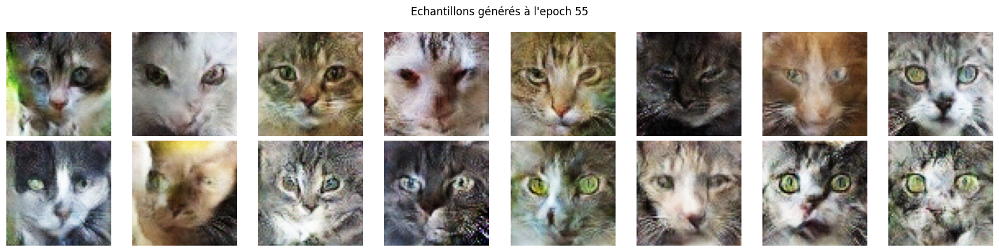

Epoch [56/100]  D_loss: 0.3963  G_loss: 0.6628
Epoch [57/100]  D_loss: 0.5501  G_loss: 1.3507
Epoch [58/100]  D_loss: 0.7882  G_loss: 0.4159
Epoch [59/100]  D_loss: 0.4199  G_loss: 0.7938
Epoch [60/100]  D_loss: 0.4935  G_loss: 1.0735


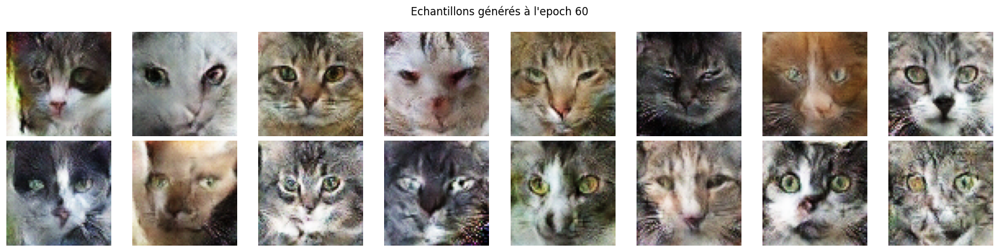

Epoch [61/100]  D_loss: 0.5507  G_loss: 1.3860
Epoch [62/100]  D_loss: 0.4417  G_loss: 0.4036
Epoch [63/100]  D_loss: 0.4345  G_loss: 0.9438
Epoch [64/100]  D_loss: 0.7022  G_loss: 0.4038
Epoch [65/100]  D_loss: 0.4154  G_loss: 0.5636


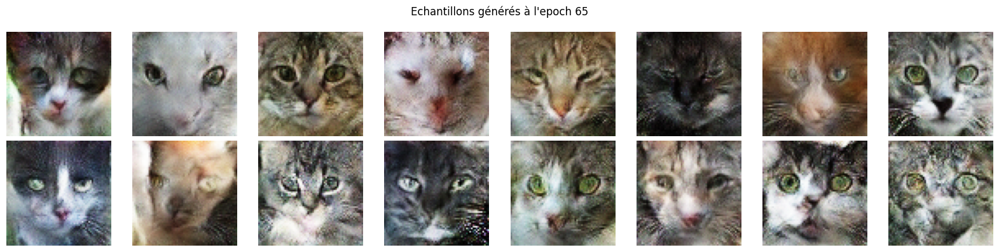

Epoch [66/100]  D_loss: 0.3669  G_loss: 0.8260
Epoch [67/100]  D_loss: 0.5717  G_loss: 0.9672
Epoch [68/100]  D_loss: 0.3942  G_loss: 0.6533
Epoch [69/100]  D_loss: 0.4116  G_loss: 0.8405
Epoch [70/100]  D_loss: 0.5351  G_loss: 0.3721


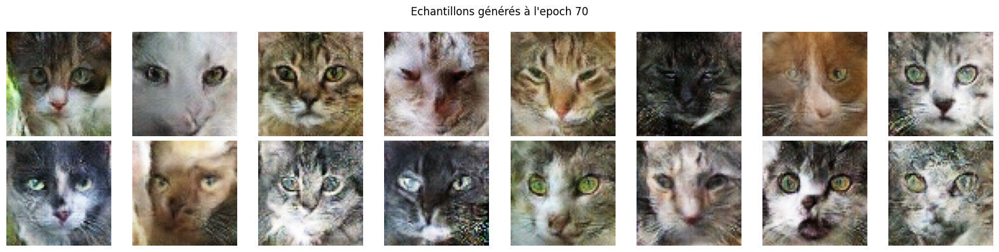

Epoch [71/100]  D_loss: 0.4045  G_loss: 0.6877
Epoch [72/100]  D_loss: 0.5119  G_loss: 0.5355
Epoch [73/100]  D_loss: 0.4186  G_loss: 0.9307
Epoch [74/100]  D_loss: 0.6274  G_loss: 1.5773
Epoch [75/100]  D_loss: 0.4529  G_loss: 0.5285


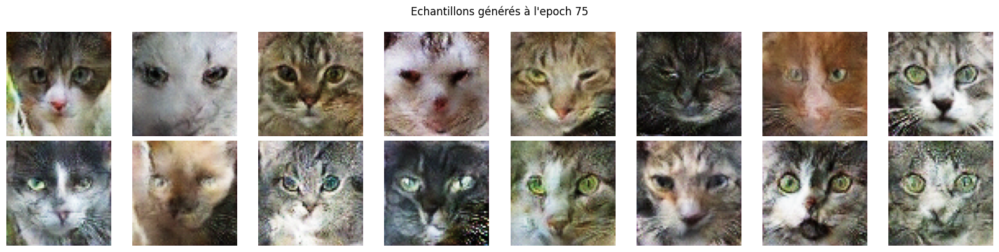

Epoch [76/100]  D_loss: 0.4478  G_loss: 0.4446
Epoch [77/100]  D_loss: 0.4735  G_loss: 1.1711
Epoch [78/100]  D_loss: 0.5141  G_loss: 0.9997
Epoch [79/100]  D_loss: 0.4772  G_loss: 1.1159
Epoch [80/100]  D_loss: 0.3959  G_loss: 0.6092


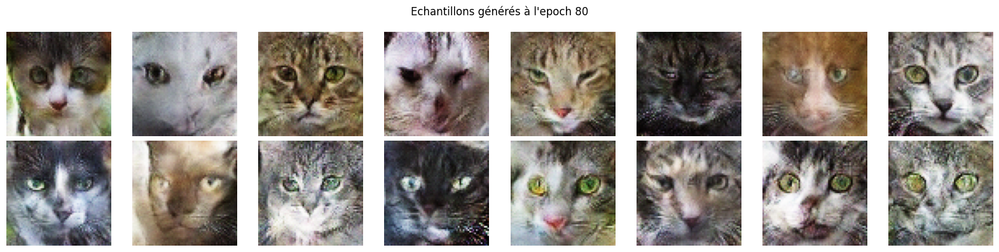

Epoch [81/100]  D_loss: 0.5582  G_loss: 1.1065
Epoch [82/100]  D_loss: 0.4417  G_loss: 0.6696
Epoch [83/100]  D_loss: 0.3755  G_loss: 0.5456
Epoch [84/100]  D_loss: 0.3648  G_loss: 0.4943
Epoch [85/100]  D_loss: 0.5705  G_loss: 0.3629


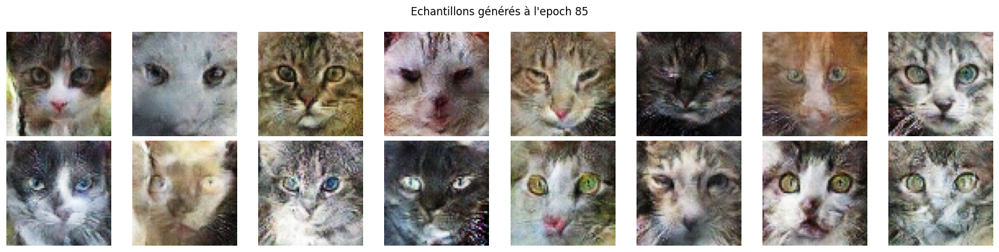

Epoch [86/100]  D_loss: 0.3716  G_loss: 0.4663
Epoch [87/100]  D_loss: 0.3774  G_loss: 0.4202
Epoch [88/100]  D_loss: 0.4478  G_loss: 0.7239
Epoch [89/100]  D_loss: 0.3868  G_loss: 0.5187
Epoch [90/100]  D_loss: 0.3876  G_loss: 0.4477


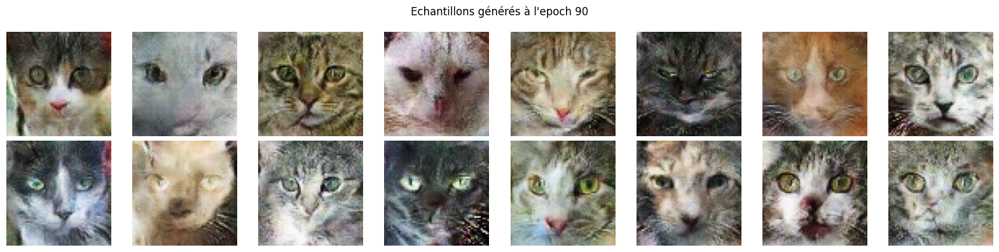

Epoch [91/100]  D_loss: 0.3878  G_loss: 0.7762
Epoch [92/100]  D_loss: 0.3629  G_loss: 0.5112
Epoch [93/100]  D_loss: 0.3492  G_loss: 0.3438
Epoch [94/100]  D_loss: 0.3434  G_loss: 0.3564
Epoch [95/100]  D_loss: 0.3360  G_loss: 0.3423


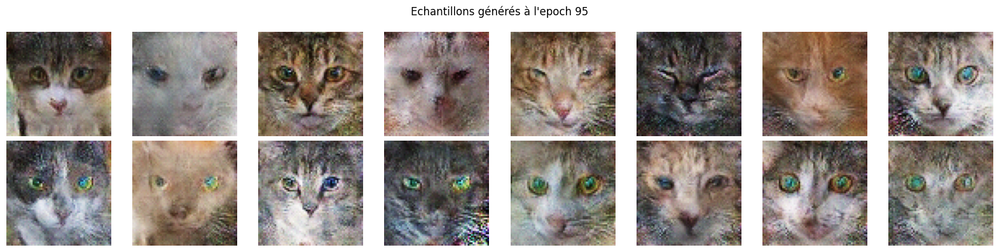

Epoch [96/100]  D_loss: 0.3427  G_loss: 0.3426
Epoch [97/100]  D_loss: 0.3370  G_loss: 0.3424
Epoch [98/100]  D_loss: 0.3342  G_loss: 0.3375
Epoch [99/100]  D_loss: 0.3363  G_loss: 0.3399
Epoch [100/100]  D_loss: 0.3301  G_loss: 0.3389


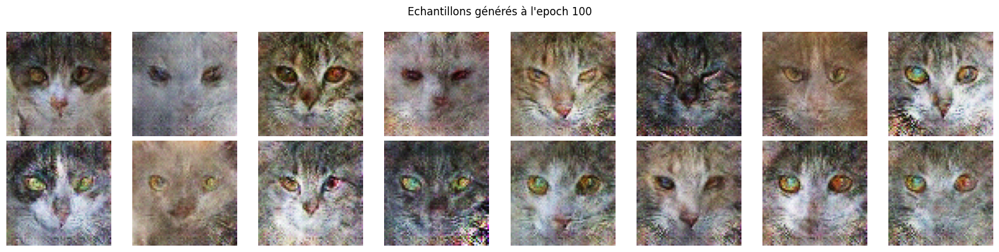

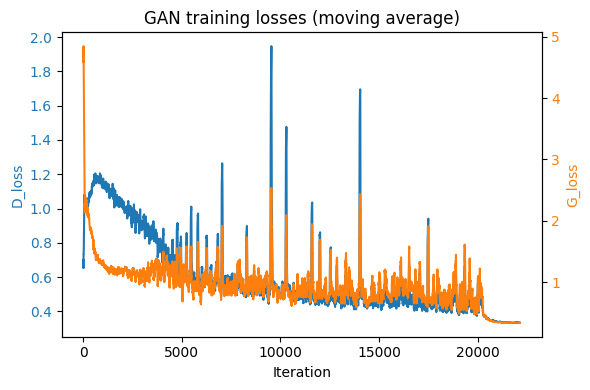

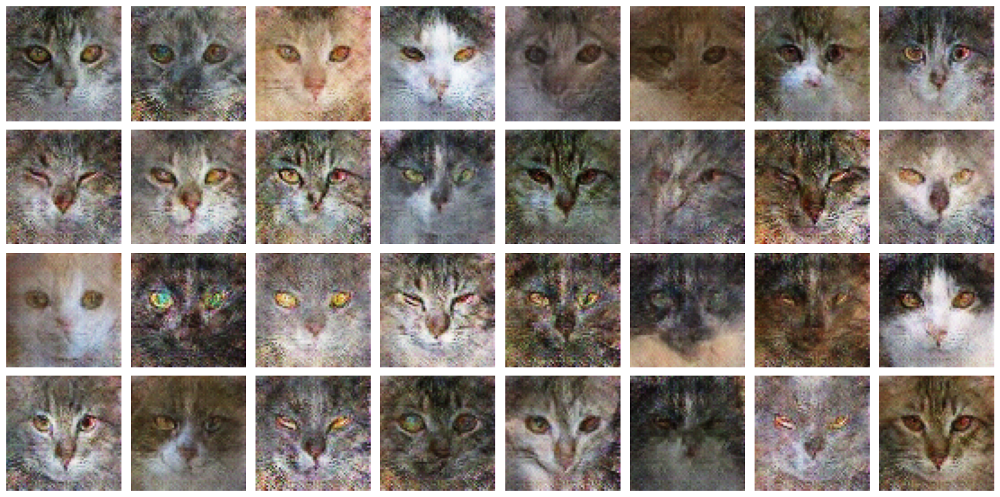

In [10]:
# 1. Initialisation modèles

latent_dim = 128
G = Generator(latent_dim).to(device)
D = Discriminator().to(device)

# Test rapide des shapes
z = torch.randn(16, latent_dim, device=device)
fake = G(z)
print("fake:", fake.shape)   # attendu: torch.Size([16, 3, 64, 64])
out = D(fake)
print("D(fake):", out.shape) # attendu: torch.Size([16, 1])

# 2. Optimiseurs + loss

lr_G = 2e-4
lr_D = 1e-4

optimizer_D = torch.optim.Adam(D.parameters(), lr=lr_D, betas=(0.0, 0.999))
optimizer_G = torch.optim.Adam(G.parameters(), lr=lr_G, betas=(0.5, 0.999))
criterion = nn.BCELoss()


# 3. Boucle d'entraînement

num_epochs = 100

G_losses = []
D_losses = []

# Bruit fixe pour visualisations intermédiaires
fixed_noise = torch.randn(16, latent_dim, device=device)

sigma = 0.05  # intensité du bruit pour le discriminateur

for epoch in range(num_epochs):
    for batch in train_loader:
        real_images = batch[0].to(device)        # (B, 3, 64, 64)
        batch_size = real_images.size(0)

        # Label smoothing : réel = 0.9, faux = 0.0
        real_labels = torch.ones(batch_size, 1, device=device) * 0.9
        fake_labels = torch.zeros(batch_size, 1, device=device)


        # 1) Mise à jour du Discriminateur
        optimizer_D.zero_grad()

        # Génération des fausses images
        noise = torch.randn(batch_size, latent_dim, device=device)
        fake_images = G(noise)

        # Ajout d'un léger bruit gaussien pour stabiliser D
        real_noisy = real_images + sigma * torch.randn_like(real_images)
        fake_noisy = fake_images.detach() + sigma * torch.randn_like(fake_images)

        # On reste dans la plage [-1, 1] (sortie du générateur avec Tanh)
        real_noisy = torch.clamp(real_noisy, -1, 1)
        fake_noisy = torch.clamp(fake_noisy, -1, 1)

        # D sur vraies images
        out_real = D(real_noisy)
        loss_real = criterion(out_real, real_labels)

        # D sur fausses images
        out_fake = D(fake_noisy)
        loss_fake = criterion(out_fake, fake_labels)

        d_loss = loss_real + loss_fake
        d_loss.backward()
        optimizer_D.step()

        # 2) Mise à jour du Générateur
        optimizer_G.zero_grad()

        noise = torch.randn(batch_size, latent_dim, device=device)
        fake_images = G(noise)
        out_fake_for_G = D(fake_images)

        # Le générateur veut que D(faux) = "réel"
        g_loss = criterion(out_fake_for_G, real_labels)

        g_loss.backward()
        optimizer_G.step()

        D_losses.append(d_loss.item())
        G_losses.append(g_loss.item())

    print(f"Epoch [{epoch+1}/{num_epochs}]  D_loss: {d_loss.item():.4f}  G_loss: {g_loss.item():.4f}")

    # Visualisation intermédiaire tous les 5 epochs
    if (epoch + 1) % 5 == 0:
        G.eval()
        with torch.no_grad():
            fake_vis = G(fixed_noise).detach().cpu()
        G.train()

        # [-1, 1] -> [0, 1] pour affichage
        fake_vis = (fake_vis + 1) / 2

        fig, axes = plt.subplots(2, 8, figsize=(16, 4))
        for i in range(16):
            ax = axes[i // 8, i % 8]
            img = fake_vis[i].permute(1, 2, 0).numpy()
            img = np.clip(img, 0, 1)
            ax.imshow(img)
            ax.axis("off")
        plt.suptitle(f"Echantillons générés à l'epoch {epoch+1}")
        plt.tight_layout()
        plt.show()

# 4. Courbes de loss (lissées)
def moving_average(x, window=50):
    x = np.array(x)
    if len(x) < window:
        return x
    return np.convolve(x, np.ones(window)/window, mode="valid")

d_smooth = moving_average(D_losses, window=50)
g_smooth = moving_average(G_losses, window=50)
iters = np.arange(len(d_smooth))

fig, ax1 = plt.subplots(figsize=(6, 4))

ax1.plot(iters, d_smooth, label="D_loss (smooth)", color="C0")
ax1.set_xlabel("Iteration")
ax1.set_ylabel("D_loss", color="C0")
ax1.tick_params(axis="y", labelcolor="C0")

ax2 = ax1.twinx()
ax2.plot(iters, g_smooth, label="G_loss (smooth)", color="C1")
ax2.set_ylabel("G_loss", color="C1")
ax2.tick_params(axis="y", labelcolor="C1")

plt.title("GAN training losses (moving average)")
fig.tight_layout()
plt.show()

# 5. Grille finale d'images générées
G.eval()
with torch.no_grad():
    z = torch.randn(32, latent_dim, device=device)
    samples = G(z).detach().cpu()

samples = (samples + 1) / 2  # [-1,1] -> [0,1]

fig, axes = plt.subplots(4, 8, figsize=(16, 8))
for i in range(32):
    ax = axes[i // 8, i % 8]
    img = samples[i].permute(1, 2, 0).numpy()
    img = np.clip(img, 0, 1)
    ax.imshow(img)
    ax.axis("off")
plt.tight_layout()
plt.show()

# **Sampling New Cat Faces with the Trained DCGAN**

After training the DCGAN, we can generate new synthetic cat faces by sampling
random latent vectors \( z \sim \mathcal{N}(0, I) \) and feeding them directly
into the **Generator**.

Unlike the VAE, a DCGAN does not use an encoder or a reparameterization step.
The generator is a standalone neural network that maps latent vectors to images:

$$[
G: \mathbb{R}^{\text{latent\_dim}} \rightarrow \mathbb{R}^{3 \times 64 \times 64}
]$$

The workflow is:

1. Sample random noise $( z )$ from a standard normal distribution.
2. Pass $( z )$ through the generator: $( x = G(z) )$.
3. Convert the output from the $([-1, 1])$ range (Tanh output) to $([0, 1])$.
4. Display the generated images.

The samples produced are **not copies** of the dataset but new images drawn
from the learned model distribution.

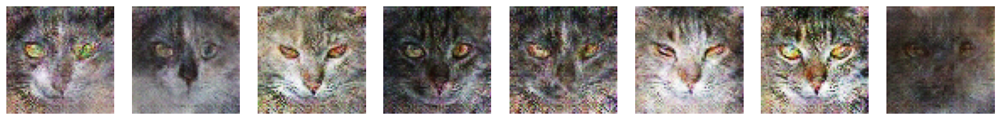

In [11]:
# Generate new synthetic cat faces using the trained DCGAN

G.eval()  # inference mode

n_samples = 8                     # number of images to generate
latent_dim = latent_dim           # ensure same latent_dim as during training

with torch.no_grad():
    # Sample latent vectors z ~ N(0, I)
    z = torch.randn(n_samples, latent_dim, device=device)
    
    # Generate images
    samples = G(z)                # shape: (n_samples, 3, 64, 64)

# Convert images from [-1, 1] (Tanh) to [0, 1] for display
samples = (samples + 1) / 2
samples = samples.cpu()

# Display the generated images
fig, axes = plt.subplots(1, n_samples, figsize=(2*n_samples, 2))

for i in range(n_samples):
    img = samples[i].permute(1, 2, 0).numpy()
    axes[i].imshow(np.clip(img, 0, 1))
    axes[i].axis("off")

plt.tight_layout()
plt.show()

# **Saving the Trained DCGAN Generator**

To reuse the trained generator later (for inference, comparison with other
generative models, or for a separate evaluation notebook), we save its weights
using `torch.save`.

Only the **Generator** needs to be saved, since it is the model that produces
new images from latent vectors.

In [12]:
save_path = "../models/dcgan_generator_cats.pth"

torch.save(G.state_dict(), save_path)
print(f"Generator successfully saved to: {save_path}")

Generator successfully saved to: ../models/dcgan_generator_cats.pth
